<a href="https://colab.research.google.com/github/itzrnvr/opencv-labs/blob/main/lab9.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lab 9

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [7]:
IMG_PATH_A = "image1.jpg"
IMG_PATH_B = "image22.jpeg"

SIFT keypoints: Image 1


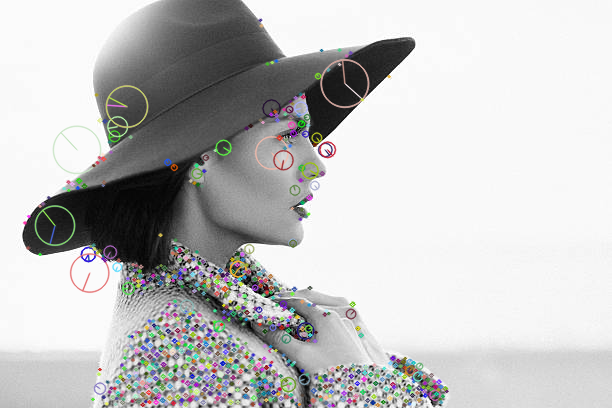

SIFT keypoints: Image 2


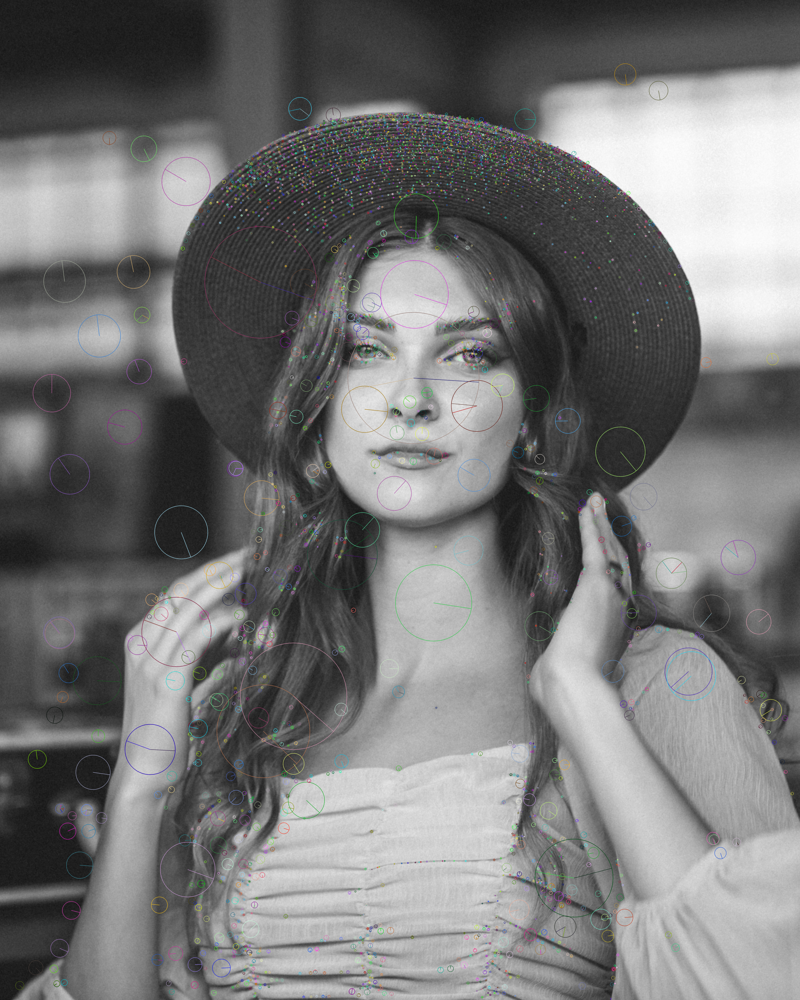

ORB + BFMatcher Feature Matching


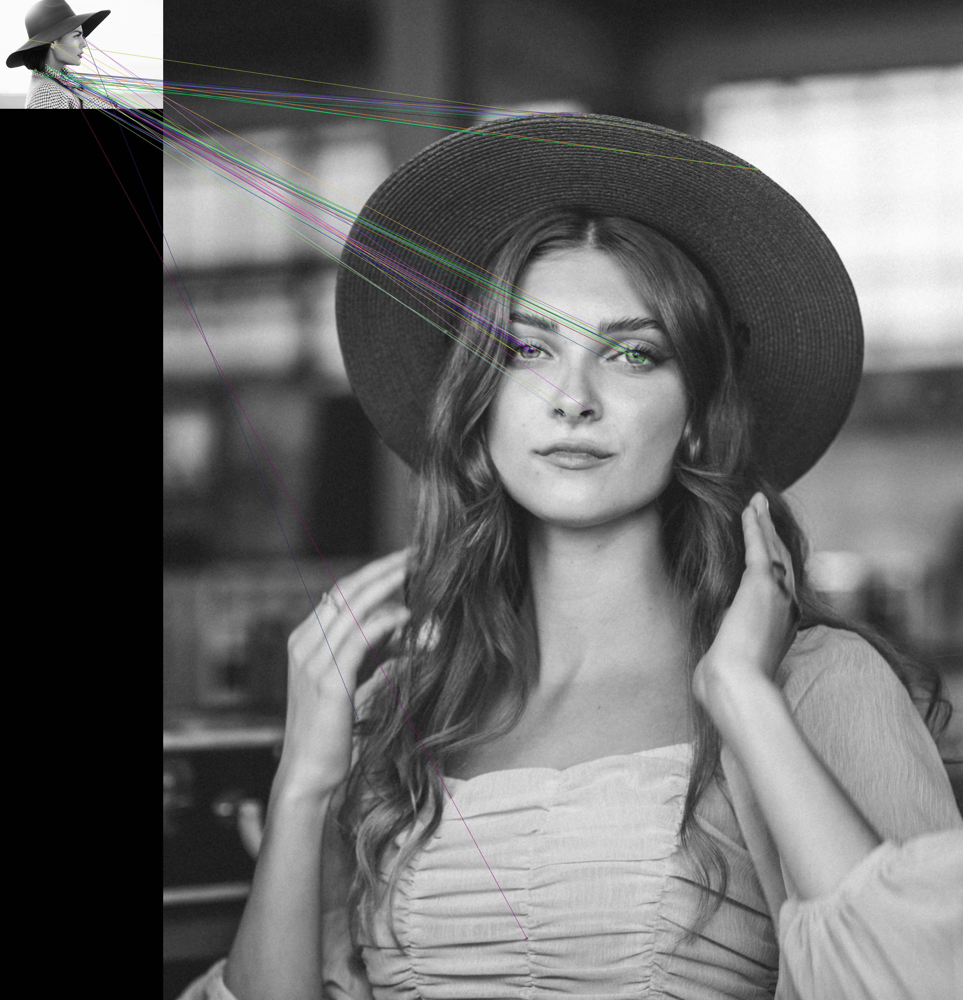

Contour Detection


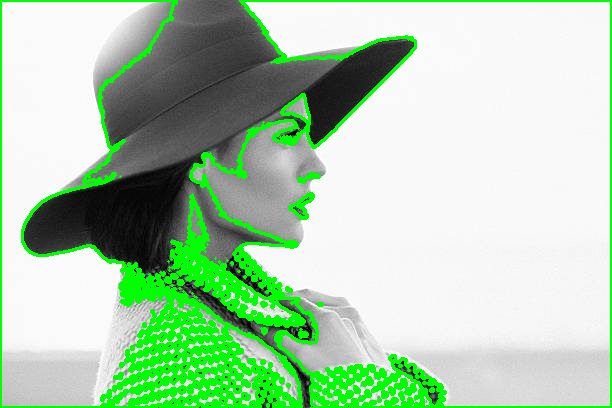

Done!


In [8]:
pic1 = cv2.imread(IMG_PATH_A, cv2.IMREAD_GRAYSCALE)
pic2 = cv2.imread(IMG_PATH_B, cv2.IMREAD_GRAYSCALE)
print("SIFT keypoints: Image 1")
sf = cv2.SIFT_create()
kpA, desA = sf.detectAndCompute(pic1, None)
kpB, desB = sf.detectAndCompute(pic2, None)
drawA = cv2.drawKeypoints(pic1, kpA, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
drawB = cv2.drawKeypoints(pic2, kpB, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(drawA)
print("SIFT keypoints: Image 2")
cv2_imshow(drawB)
print("ORB + BFMatcher Feature Matching")
orb_f = cv2.ORB_create()
ka, da = orb_f.detectAndCompute(pic1, None)
kb, db = orb_f.detectAndCompute(pic2, None)
bmatch = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
m_o = bmatch.match(da, db)
m_o = sorted(m_o, key=lambda e: e.distance)
img_matched = cv2.drawMatches(pic1, ka, pic2, kb, m_o[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
cv2_imshow(img_matched)
print("Contour Detection")
c_img = cv2.imread(IMG_PATH_A)
gray_c = cv2.cvtColor(c_img, cv2.COLOR_BGR2GRAY)
__, t = cv2.threshold(gray_c, 127, 255, cv2.THRESH_BINARY)
cnt, _ = cv2.findContours(t, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(c_img, cnt, -1, (0,255,0), 2)
cv2_imshow(c_img)
print("Done!")

Training InceptionNet-V3...
Epoch 1/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 369s 227ms/step - accuracy: 0.5181 - loss: 1.3905 - val_accuracy: 0.6135 - val_loss: 1.1284
Epoch 2/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 27s 17ms/step - accuracy: 0.6487 - loss: 1.0072 - val_accuracy: 0.6218 - val_loss: 1.0896
Epoch 3/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 39s 16ms/step - accuracy: 0.6896 - loss: 0.8769 - val_accuracy: 0.6248 - val_loss: 1.0831
Epoch 4/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 41s 16ms/step - accuracy: 0.7291 - loss: 0.7720 - val_accuracy: 0.6280 - val_loss: 1.1220
Epoch 5/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 41s 16ms/step - accuracy: 0.7602 - loss: 0.6799 - val_accuracy: 0.6148 - val_loss: 1.2072


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Training GAN...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 847ms/step


/usr/local/lib/python3.11/dist-packages/keras/src/backend/tensorflow/trainer.py:82: UserWarning: The model does not have any trainable weights.
  warnings.warn("The model does not have any trainable weights.")


Epoch 1/5, D Loss Real: 0.6678353548049927, D Loss Fake: 0.6706920266151428, GAN Loss: 0.6808273792266846
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
Epoch 2/5, D Loss Real: 0.6690405011177063, D Loss Fake: 0.6708418130874634, GAN Loss: 0.6784494519233704
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Epoch 3/5, D Loss Real: 0.6659663319587708, D Loss Fake: 0.6681663393974304, GAN Loss: 0.6756650805473328
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Epoch 4/5, D Loss Real: 0.667754590511322, D Loss Fake: 0.6698598265647888, GAN Loss: 0.6699142456054688
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Epoch 5/5, D Loss Real: 0.6703336238861084, D Loss Fake: 0.6713612675666809, GAN Loss: 0.6657360196113586
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


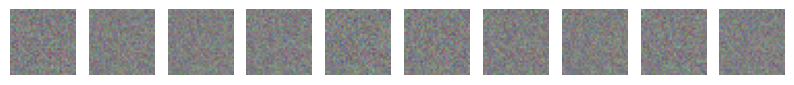

Training Completed!


In [9]:
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.datasets import cifar10
import numpy as np
import matplotlib.pyplot as plt
setA, setB = cifar10.load_data()
(xtr, ytr), (xte, yte) = setA, setB
xtr = xtr / 255.0
xte = xte / 255.0
base = InceptionV3(weights='imagenet', include_top=False, input_shape=(75,75,3))
hid = Flatten()(base.output)
hid = Dense(128, activation='relu')(hid)
preds = Dense(10, activation='softmax')(hid)
net = Model(inputs=base.input, outputs=preds)
for lyr in base.layers:
    lyr.trainable = False
net.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
xtr_sz = tf.image.resize(xtr, (75,75))
xte_sz = tf.image.resize(xte, (75,75))
print("Training InceptionNet-V3...")
net.fit(xtr_sz, ytr, validation_data=(xte_sz, yte), epochs=5, batch_size=32)
from tensorflow.keras.layers import Input, Reshape, Conv2DTranspose, Conv2D, LeakyReLU, Dropout, BatchNormalization
def gnet():
    return Sequential([
        Dense(256, input_dim=100, activation='relu'),
        BatchNormalization(),
        Dense(512, activation='relu'),
        BatchNormalization(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dense(32 * 32 * 3, activation='tanh'),
        Reshape((32, 32, 3))
    ])
gen = gnet()
def dnet():
    return Sequential([
        Conv2D(64, (3,3), strides=(2,2), padding='same', input_shape=(32,32,3)),
        LeakyReLU(alpha=0.2),
        Dropout(0.3),
        Conv2D(128, (3,3), strides=(2,2), padding='same'),
        LeakyReLU(alpha=0.2),
        Dropout(0.3),
        Flatten(),
        Dense(1, activation='sigmoid')
    ])
disc = dnet()
disc.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
disc.trainable = False
inp = Input(shape=(100,))
gan_out = disc(gen(inp))
gan = Model(inp, gan_out)
gan.compile(optimizer='adam', loss='binary_crossentropy')
print("Training GAN...")
epochs_gan = 5
bsz = 32
hbsz = bsz // 2
gan_losses = []
for ep in range(epochs_gan):
    idx = np.random.randint(0, xtr.shape[0], hbsz)
    real = xtr[idx]
    z = np.random.normal(0,1,(hbsz,100))
    fake = gen.predict(z)
    lbl_r = np.ones((hbsz,1))
    lbl_f = np.zeros((hbsz,1))
    l_r = disc.train_on_batch(real, lbl_r)
    l_f = disc.train_on_batch(fake, lbl_f)
    z = np.random.normal(0,1,(bsz,100))
    loss_gan = gan.train_on_batch(z, np.ones((bsz,1)))
    gan_losses.append(loss_gan)
    print(f"Epoch {ep+1}/{epochs_gan}, D Loss Real: {l_r[0]}, D Loss Fake: {l_f[0]}, GAN Loss: {loss_gan}")
noise = np.random.normal(0,1,(10,100))
Xgen = gen.predict(noise)
Xgen = (Xgen + 1) / 2.0
fig, axs = plt.subplots(1,10,figsize=(10,2))
for i in range(10):
    axs[i].imshow(Xgen[i])
    axs[i].axis('off')
plt.show()
print("Training Completed!")